# Outliers - Project Fundamentals of Information System
## Ngoc Diem Le, Marina Vicini, Francesco Vinci
### ID: Covid19Tweets
*Data: http://www.dei.unipd.it/~silvello/FIS2020/covid19Tweets.zip*

The following notebook desires to analyze the data of tweets related to Covid-19. These tweets have been collected using Twitter API and a Python Script. Two main points will be implemented. The first is to analyze the trends of COVID-19 subjects following a temporal and spatial distribution that will be achieved through graphs and maps. The second is to investigate the sentiment of the tweets.

Our analysis will follow this structure:

*  <a href='#cleaning'>Cleaning Data<a/>
*  <a href='#trends'>Analyzing Trends<a/>
*  <a href='#sentiment'>Sentiment Analysis<a/> 
*  <a href='#dash'>Dashboard<a/> 
*  <a href='#references'>References<a/>


<a id='cleaning'></a>
## Cleaning Data

In this first part we want to clean the dataset. We will first import the required libraries, and then we will look at the dataset. After removing unnecessary columns, we want to clean the data related to the dates, the text of the tweets and the location.

* <a href='#cleaning_dates'>Dates<a/>
* <a href='#cleaning_texts'>Texts<a/>
* <a href='#cleaning_locations'>Locations<a/>

In [1]:
# import some useful libraries

import os
import numpy as np
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# import data
df = pd.read_csv(r'data/covid19_tweets.csv')

In [3]:
df.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin i...,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN,Twitter for iPhone,False
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Auth...",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN,Twitter for Android,False
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Re...,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19'],Twitter for Android,False
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs ...,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19'],Twitter for iPhone,False
4,DIPR-J&K,Jammu and Kashmir,🖊️Official Twitter handle of Department of Inf...,2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False


In the dataset there are many columns that are not useful for our analysis. Therefore, we want to remove them.

In [4]:
# delete useless columns

del df['user_created']
del df['user_followers']
del df['user_friends']
del df['user_favourites']
del df['source']
del df['is_retweet']
del df['user_description']

In [5]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags
0,ᏉᎥ☻լꂅϮ,astroworld,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN
1,Tom Basile 🇺🇸,"New York, NY",True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN
2,Time4fisticuffs,"Pewee Valley, KY",False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19']
3,ethel mertz,Stuck in the Middle,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19']
4,DIPR-J&K,Jammu and Kashmir,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']"


<a id='cleaning_dates'></a>
#### Clean the dates
Since all the tweets have been collected in 2020, we will only consider the day and the month. Moreover, we can notice that the data has been collected in a period that spans from July 25th to August 29th.

In [6]:
#df.date = pd.to_datetime(df.date).dt.date        # type of date is datetime.date // format: yyyy-mm-dd 
df["date"] = df["date"].apply(lambda x: x[5:10])  # date yyyy-mm-dd hh:mm:ss --> mm-dd

In [7]:
df.date.unique()

array(['07-25', '07-24', '07-26', '07-27', '07-28', '07-29', '07-30',
       '07-31', '08-01', '08-02', '08-04', '08-06', '08-07', '08-08',
       '08-09', '08-10', '08-11', '08-12', '08-13', '08-14', '08-16',
       '08-17', '08-18', '08-22', '08-30', '08-29'], dtype=object)

In [8]:
df.sort_values(by=['date'], inplace=True)   # sort the df by date

In [9]:
df = df.reset_index(drop=True)

In [10]:
df

,user_name,user_location,user_verified,date,text,hashtags
0,insightfultroll,NaN,False,07-24,"I'm glad I'm in Canada, You can see why the pa...",NaN
1,GlobalPandemic.NET,WORLDWIDE,False,07-24,"ALERT: After Times investigation, Newsom says ...",NaN
2,Euan Watt,"Manchester, England",False,07-24,Having checked the data of all nation's of the...,NaN
3,GlobalPandemic.NET,WORLDWIDE,False,07-24,ALERT: Doctors Post Bikini Photos To Protest S...,NaN
4,Brian,"New York, USA",False,07-24,@CNN But not a word about #COVID19 spread for ...,['COVID19']
...,...,...,...,...,...,...
179103,RAKAN Sarawak,"Kuching, Sarawak",False,08-30,WHO calls for protecting and preserving nature...,['COVID19']
179104,b-yond tv,NaN,False,08-30,#CultureFact: As the world adapts to #WorkFrom...,"['CultureFact', 'WorkFromHome', 'COVID19']"
179105,GlobalCapital Asia,Asia,False,08-30,"Crisis Talk — with Thomas Hugger, CEO of Asia ...","['covid19', 'investing', 'capitalmarkets']"
179106,SV News 🚨,Turn On Notifications 🔔,False,08-30,Massive anti-mask and anti-#COVID19 lockdown p...,"['COVID19', 'Berlin']"


<a id='cleaning_texts'></a>
#### Clean the texts
We want to clean the text of the tweets, removing mentions, retweet count and hyperlinks.

In [11]:
from nltk import sent_tokenize
df['text'] = df['text'].apply(sent_tokenize)    # create a list of sentences for each tweet

In [12]:
# clean sentence 
def clean_sent(sent):
    sent = sent.lower()
    sent = re.sub('@[A-Za-z0–9]+', '', sent) # remove @mentions
    sent = re.sub('RT[\s]+', '', sent) # remove RT
    sent = re.sub('https?:\/\/\S+', '', sent) # remove hyperlink
    return sent

# clean the whole text
def clean_text(text):
    for i in range(len(text)):
        sent = clean_sent(text[i])
        text[i] = sent
    return text

df['text'] = df['text'].apply(clean_text)

In [13]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags
0,insightfultroll,NaN,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN
1,GlobalPandemic.NET,WORLDWIDE,False,07-24,"[alert: after times investigation, newsom says...",NaN
2,Euan Watt,"Manchester, England",False,07-24,[having checked the data of all nation's of th...,NaN
3,GlobalPandemic.NET,WORLDWIDE,False,07-24,[alert: doctors post bikini photos to protest ...,NaN
4,Brian,"New York, USA",False,07-24,[ but not a word about #covid19 spread for the...,['COVID19']


<a id='cleaning_locations'></a>
#### Clean Locations
We start by formatting the string in the column 'user_location'. We import the library `geopy` to convert the string into the corresponding country. Note that the computational cost of this step is high, so we saved the output into a dataset with cleaned data.

In [14]:
import string

def clean_loc(loc):
    try:
        loc = loc.lower()
        loc = re.sub(r'[^\w\s]', '', loc) # remove punctuations
        loc = re.sub('https?:\/\/\S+', '', loc) # remove hyperlink
        loc = "".join([x for x in loc if x in string.printable]) # remove weird character
        #loc = re.sub('[(\U0001F600-\U0001F92F|\U0001F300-\U0001F5FF|\U0001F680-\U0001F6FF|\U0001F190-\U0001F1FF|\U00002702-\U000027B0|\U0001F926-\U0001FA9F|\u200d|\u2640-\u2642|\u2600-\u2B55|\u23cf|\u23e9|\u231a|\ufe0f)]+','',loc) # remove emoji
        return loc
    except AttributeError:
        return None

df["user_location"] = df["user_location"].apply(clean_loc)

In [15]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags
0,insightfultroll,None,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN
1,GlobalPandemic.NET,worldwide,False,07-24,"[alert: after times investigation, newsom says...",NaN
2,Euan Watt,manchester england,False,07-24,[having checked the data of all nation's of th...,NaN
3,GlobalPandemic.NET,worldwide,False,07-24,[alert: doctors post bikini photos to protest ...,NaN
4,Brian,new york usa,False,07-24,[ but not a word about #covid19 spread for the...,['COVID19']


In [16]:
# !pip install geopy

In [17]:
from geopy.geocoders import Nominatim
from geopy import exc

# create a geocoder
geolocator = Nominatim(user_agent = 'YOUR_EMAIL_HERE',timeout = 1)

In [18]:
# create a function that gives me the country of the location
# the computational cost of this function is high !

def get_country(loc):
    
    if type(loc) != str:
        return None
    
    try:
        loc = geolocator.geocode(loc, language='en')           # loc = Location(address, (long, lat)) 
    except exc.GeopyError:
        return None                             
    
    if type(loc) == type(None):
        return None
    
    loc = loc.address.split(", ")[-1]           # the country is at the end of the address 
    return loc

In [19]:
# from tqdm import tqdm
# it takes almost 4 hours!

#dict_usloc = {raw_loc : get_country(raw_loc) for raw_loc in tqdm(pd.unique(df["user_location"].dropna()))}

In [20]:
# save the dict in a txt file: dict_usloc.txt

#with open('data/dict_usloc.txt', 'w') as outfile:
#    outfile.write(str(dict_usloc))

In [21]:
#import ast

#file = open(r"data/dict_usloc.txt", "r")
#contents = file.read()
#dict_usloc = ast.literal_eval(contents)

In [22]:
# change raw user_location to clean user_location in df

#def loc_raw_to_clean(lraw):
    
#    if type(lraw) != str:
#        return np.nan
#    return dict_usloc[lraw]

#df['user_location'] = df['user_location'].apply(loc_raw_to_clean)

In [23]:
# save the clean DataFrame as csv file

#df.to_csv(r'df.csv', index= False)

In [24]:
# load cleaned df

df = pd.read_csv('./data/df.csv')
df.head()

,user_name,user_location,user_verified,date,text,hashtags
0,insightfultroll,NaN,False,07-24,"[""i'm glad i'm in canada, you can see why the ...",NaN
1,GlobalPandemic.NET,United Kingdom,False,07-24,"['alert: after times investigation, newsom say...",NaN
2,Euan Watt,United Kingdom,False,07-24,"[""having checked the data of all nation's of t...",NaN
3,GlobalPandemic.NET,United Kingdom,False,07-24,['alert: doctors post bikini photos to protest...,NaN
4,Brian,United States,False,07-24,[' but not a word about #covid19 spread for th...,['COVID19']


In [25]:
import ast

df['text'] = df.text.apply(ast.literal_eval)

##### Users verified
We want to check how many users are verified, and we want to study the DataFrame by user (verified or not), by dates and by user_location.

/home/francesco/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


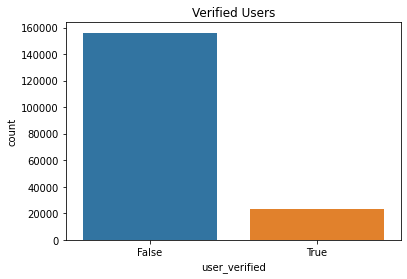

In [26]:
sns.countplot(df['user_verified'])
plt.title('Verified Users')
plt.show()

In [27]:
def df_usver(usver=True):
    if usver:
        return df[df['user_verified']]
    else:
        return df[~df['user_verified']]

In [28]:
def df_country(country):
    if country not in list(df.user_location):
        raise NameError(f"{country} is not in df['user_location']")
    else:
        return df[df.user_location == country]

In [29]:
def df_dates(d1,d2):
    if re.fullmatch("[0-1][0-9]-[0-3][0-9]",d1) and re.fullmatch("[0-1][0-9]-[0-3][0-9]",d2):
        return df[(df.date >= d1) & (df.date <= d2)]
    raise NameError("Dates have to been: 'dd-mm'")

<a id='trends'></a>
## Analyzing Trends
After an intial cleaning part, we want to analyze the trends of the tweets. 
We will start by highliting:
* <a href='#trends_words'>The most used words <a/>
* <a href='#trends_hashtags'>The frequency of the hashtags<a/>
* <a href='#trends_tweets'>The number of tweets<a/>



<a id='trends_words'></a>
#### Most used words
In this section, we want to identify the words with the most recurrence in the text of the tweets. We start by tokenizing the text and removing the stopwords. Then we want to analyze the most used words by users that have been verified and not.

In [30]:
# tokenization

from nltk.tokenize import TweetTokenizer
tokenizer = TweetTokenizer()

df['text_tokenized'] = df['text'].apply(lambda x: tokenizer.tokenize(" ".join(x).lower()))

In [31]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags,text_tokenized
0,insightfultroll,NaN,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN,"[i'm, glad, i'm, in, canada, ,, you, can, see,..."
1,GlobalPandemic.NET,United Kingdom,False,07-24,"[alert: after times investigation, newsom says...",NaN,"[alert, :, after, times, investigation, ,, new..."
2,Euan Watt,United Kingdom,False,07-24,[having checked the data of all nation's of th...,NaN,"[having, checked, the, data, of, all, nation's..."
3,GlobalPandemic.NET,United Kingdom,False,07-24,[alert: doctors post bikini photos to protest ...,NaN,"[alert, :, doctors, post, bikini, photos, to, ..."
4,Brian,United States,False,07-24,[ but not a word about #covid19 spread for the...,['COVID19'],"[but, not, a, word, about, #covid19, spread, f..."


In [32]:
#nltk.download('stopwords')

In [33]:
# remove stopwords
import nltk
from nltk.corpus import stopwords

stopword = nltk.corpus.stopwords.words('english')

def remove_stopwords(text):
    text = [word for word in text if word not in stopword and word.isalnum() and not word.isnumeric()]
    return text

df['text_tokenized'] = df['text_tokenized'].apply(remove_stopwords)

In [34]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags,text_tokenized
0,insightfultroll,NaN,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN,"[glad, canada, see, pandemic, raging, united, ..."
1,GlobalPandemic.NET,United Kingdom,False,07-24,"[alert: after times investigation, newsom says...",NaN,"[alert, times, investigation, newsom, says, nu..."
2,Euan Watt,United Kingdom,False,07-24,[having checked the data of all nation's of th...,NaN,"[checked, data, uk, deaths, england]"
3,GlobalPandemic.NET,United Kingdom,False,07-24,[alert: doctors post bikini photos to protest ...,NaN,"[alert, doctors, post, bikini, photos, protest..."
4,Brian,United States,False,07-24,[ but not a word about #covid19 spread for the...,['COVID19'],"[word, spread, last, days, portland, city, mas..."


In [35]:
from nltk import FreqDist

def freq_words(data):
    list_of_all_words = []
    for l in data['text_tokenized'].values:
        list_of_all_words.extend(l)
    fdist_words = FreqDist(list_of_all_words)
    count_words = pd.Series(fdist_words.values(), index = fdist_words.keys())
    count_words = count_words.sort_values(ascending = False)
    return count_words

In [36]:
count_words = freq_words(df)

In [37]:
def barplt_count_words(n,m):
    plt.figure(figsize = (12,10))
    plt.title(f'{n+1}-{m} Most used words')
    count_words[n:m].plot.barh(count_words)

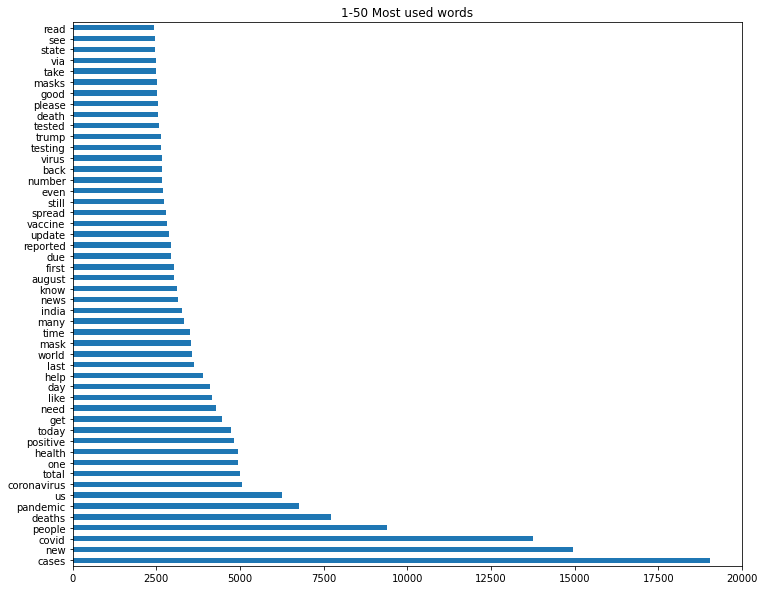

In [38]:
barplt_count_words(0,50)

In [39]:
# Usefull for the final Dashboard
# Barplot for frequency of words
import plotly.express as px

fig_frq_words = px.bar(count_words[0:20],
                       labels = {'index':'Most common words','value':'Counts'})
fig_frq_words.update_layout(showlegend = False)
fig_frq_words.update_xaxes(tickangle=45)

Most used words by verified users and not verified

In [40]:
count_words_usver = freq_words(df_usver())

In [41]:
#count_words_usver[:50]

In [42]:
count_words_usnotver = freq_words(df_usver(False))

In [43]:
#count_words_usnotver[:50]

<AxesSubplot:title={'center':'Not Verified Users'}>

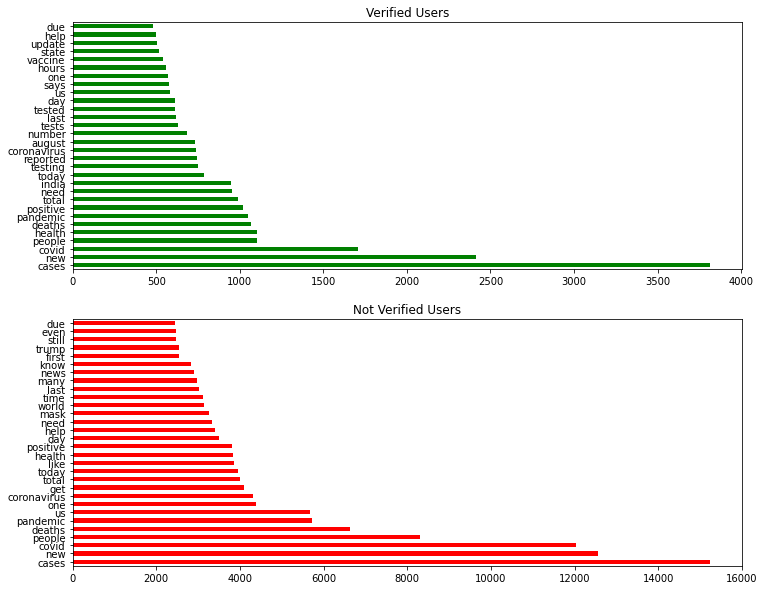

In [44]:
fig, axes = plt.subplots(2, 1, figsize = (12,10))
count_words_usver[0:30].plot.barh(ax=axes[0], color='g', title = 'Verified Users')
count_words_usnotver[0:30].plot.barh(ax=axes[1], color='r', title = 'Not Verified Users')

<a id='trends_hashtags'></a>
#### Frequency of the hashtags 
We will analyze the frequency of the hashtags through a Word Cloud, with the help of a bar race chart.

In [45]:
from nltk import FreqDist

def freq_hashtag(data):
    hashtags1 = []
    for x in list(data['hashtags'].dropna()):
        hashtags1.extend(ast.literal_eval(x))  # x is a str object like '['hashtag1','hashtag2']'
    hashtags = [x.lower() for x in hashtags1]  # list of all hashtags
    fdist = FreqDist(hashtags)                 # frequencies of hashtags
    return fdist, hashtags

fdist, hashtags = freq_hashtag(df)

In [46]:
fdist

FreqDist({'covid19': 100312, 'coronavirus': 10197, 'pandemic': 1625, 'covid': 1299, 'india': 1193, 'corona': 1162, 'trump': 1101, 'lockdown': 963, 'coronaviruspandemic': 882, 'covid_19': 828, ...})

In [47]:
def freq_hashtag_nocov(hashtags):
    hashtags_nocovid=[]
    for w in hashtags:
        if not(re.search("covid",w.lower()) or re.search("corona",w.lower())):
            hashtags_nocovid.append(w)
    fdist_nocovid = FreqDist(hashtags_nocovid)
    return fdist_nocovid

fdist_nocovid = freq_hashtag_nocov(hashtags)

In [48]:
l = dict()
for d in df.date.unique():
    l[d] = freq_hashtag_nocov(freq_hashtag(df[df.date == d])[1])

In [49]:
count_words_days = pd.DataFrame(l).T.fillna(0).cumsum()

In [50]:
count_words_days.head()

,losangeles,newyork,washington,neworleans,italia,china,spain,japan,southkorea,california,...,wi,pandemichoax,distractorandchief,trumpisdangerous,quazergraph,doccom,masonstreasurehunt,oakdalecalifornia,cakepopmaker,culturefact
07-24,1.0,2.0,1.0,1.0,1.0,2.0,1.0,2.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
07-25,6.0,13.0,1.0,1.0,3.0,45.0,8.0,7.0,6.0,19.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
07-26,8.0,16.0,3.0,2.0,4.0,73.0,30.0,11.0,13.0,25.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
07-27,10.0,24.0,6.0,5.0,6.0,110.0,38.0,19.0,24.0,34.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
07-28,15.0,26.0,8.0,7.0,8.0,153.0,44.0,29.0,28.0,41.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [51]:
#!pip3 install bar_chart_race

In [52]:
# Supress RuntimeWarning
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)      # many RuntimeWarning

import bar_chart_race as bcr
# This computes in about 4/5 minutes!!
bcr.bar_chart_race(count_words_days, 
                   n_bars= 20, 
                   #shared_fontdict={'family' : 'Helvetica', 'color' : '.1'}, 
                   filter_column_colors= True)

/home/francesco/.local/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:286: UserWarning:

FixedFormatter should only be used together with FixedLocator

/home/francesco/.local/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:287: UserWarning:

FixedFormatter should only be used together with FixedLocator



In [53]:
#!pip3 install wordcloud

In [54]:
from wordcloud import WordCloud

In [55]:
def hashtag_wordcloud(fdist):
    wc = WordCloud(width=800, height=400, max_words=50).generate_from_frequencies(fdist)  # create the wordcloud
    plt.figure(figsize=(12,10))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

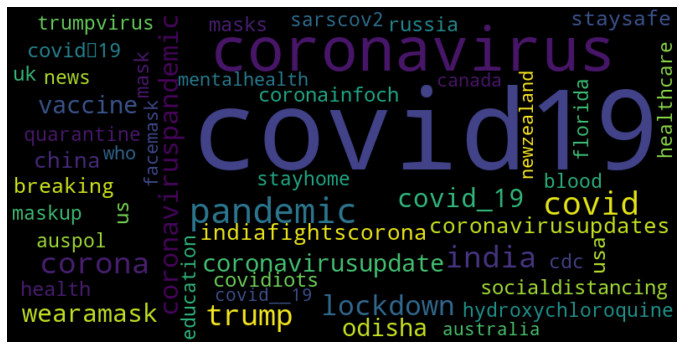

In [56]:
hashtag_wordcloud(fdist)

Let us remove the predominant words "covid" and "corona", and let us plot again another wordcloud.

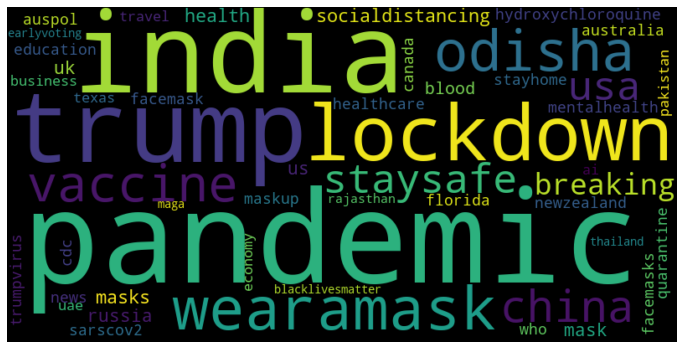

In [57]:
hashtag_wordcloud(fdist_nocovid)

As we have done before, let us plot the wordcloud, classifying them for verification of the user.

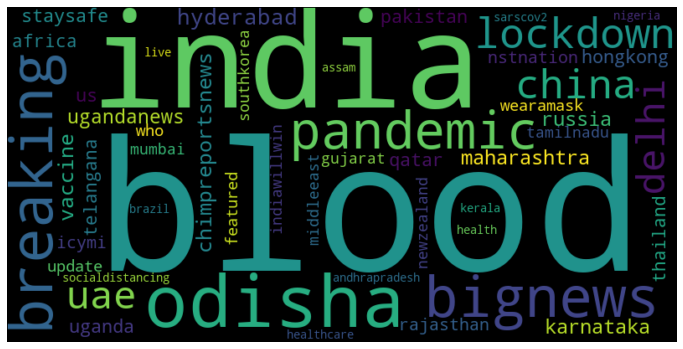

In [58]:
# wordcloud for verified user
hashtag_wordcloud(freq_hashtag_nocov(freq_hashtag(df_usver())[1]))

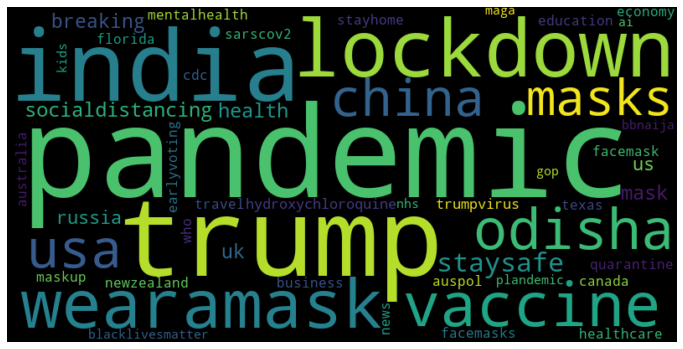

In [59]:
# wordcloud for not verified user
hashtag_wordcloud(freq_hashtag_nocov(freq_hashtag(df_usver(False))[1]))

We can also plot a wordcloud following a geographical point of here. Here below, the wordcloud of the most used hashtags are found considering the United States of America and Italy.

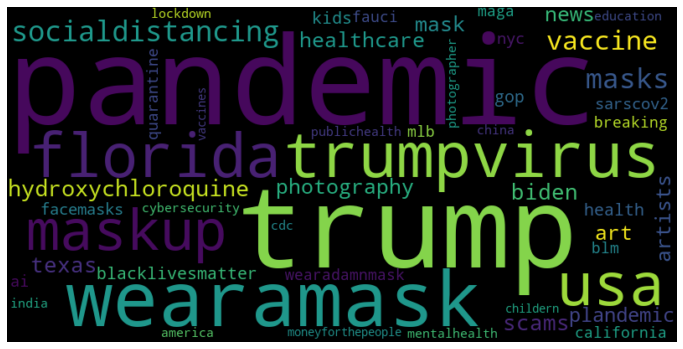

In [60]:
hashtag_wordcloud(freq_hashtag_nocov(freq_hashtag(df_country('United States'))[1]))

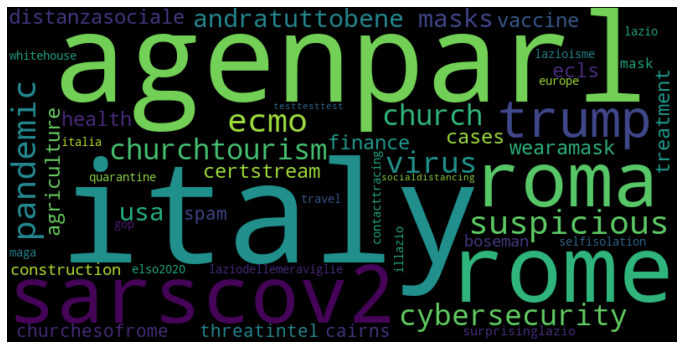

In [61]:
hashtag_wordcloud(freq_hashtag_nocov(freq_hashtag(df_country('Italy'))[1]))

<a id='trends_tweets'></a>
#### Number of Tweets
Now we want to analyze the number of tweets that have been collected. We will first plot them through a bar graph, and then we will plot another bar graph that takes into account that no tweets have been retreived in those days.

In [62]:
num_tweet_per_day = {}
for day in df.date.unique():
    num_tweet_per_day[day] = df[df.date == day]['date'].count()

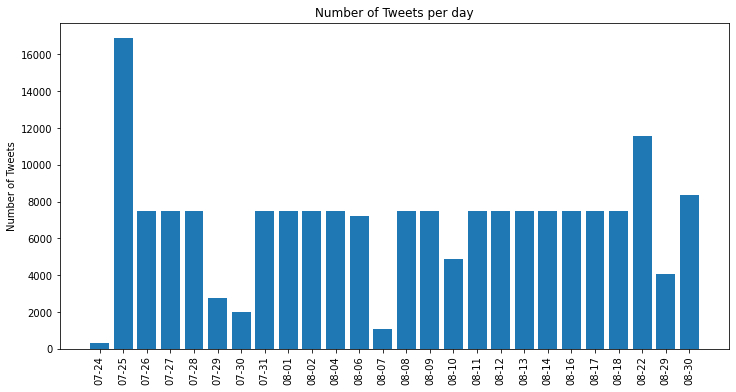

In [63]:
plt.figure(figsize= [12,6])
plt.bar(list(num_tweet_per_day.keys()), list(num_tweet_per_day.values()))
_=plt.xticks(list(num_tweet_per_day.keys()), rotation='vertical')
_=plt.ylabel('Number of Tweets')
_=plt.title('Number of Tweets per day')

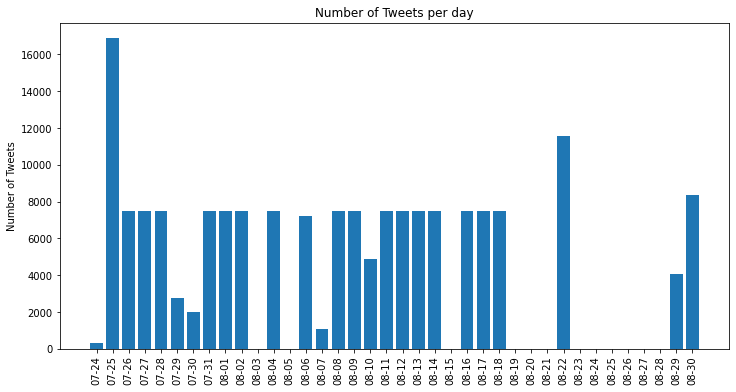

In [64]:
# Here there are days with no tweets. I check if this is correct in the original data
plt.figure(figsize= [12,6])

num_tweet_per_day_missing_col = []

#There are all the days including the ones without values
#days = pd.to_datetime(df_countries_t.columns, format = "%m-%d")
days = pd.date_range('07-24-2020', '08-30-2020')
days = [str(day)[5:10] for day in days]

for day in days:
    if day in df.date.values:
        num_tweet_per_day_missing_col.append(num_tweet_per_day[day])
    if day not in df.date.values:
        num_tweet_per_day_missing_col.append(0)


fig_number_of_tweets_per_day = plt.bar(days, num_tweet_per_day_missing_col)
_=plt.xticks(days, rotation='vertical')
_=plt.ylabel('Number of Tweets')
_=plt.title('Number of Tweets per day')
plt.show()

In [65]:
# Usefull for the final Dashboard
# Barplot for number of tweets per day

days_with_missing_value = []
for day in days:
    days_with_missing_value.append(day.replace('-','/'))

dataframe = pd.DataFrame(list(zip(days_with_missing_value, num_tweet_per_day_missing_col)), columns = ['Date', 'Counts'])

fig_number_of_tweets_per_day = px.bar(dataframe, x=dataframe['Date'], y=dataframe['Counts'])
fig_number_of_tweets_per_day.update_xaxes(title_text='Date')
fig_number_of_tweets_per_day.update_yaxes(title_text='Counts')
fig_number_of_tweets_per_day.update_layout(showlegend = False)
fig_number_of_tweets_per_day.update_xaxes(tickangle=45)

In [66]:
country_count_tweets = df.pivot_table(index = 'user_location', columns='date', values = 'text', aggfunc = 'count', fill_value = 0).T
country_cumucount_tweets = country_count_tweets.cumsum()

In [67]:
country_cumucount_tweets

user_location,Afghanistan,Africa,Albania,Algeria,Andorra,Angola,Antarctica,Argentina,Armenia,Asia,...,United Kingdom,United States,Uruguay,Uzbekistan,Vatican City,Venezuela,Vietnam,Yemen,Zambia,Zimbabwe
date,,,,,,,,,,,,,,,,,,,,,
07-24,0,0,0,0,0,0,0,0,0,0,...,15,128,0,0,0,0,0,0,0,0
07-25,9,20,4,1,0,0,2,9,6,3,...,1722,3667,1,1,2,2,16,0,6,19
07-26,18,34,5,1,1,0,4,11,8,5,...,2355,5001,2,1,2,3,22,0,10,26
07-27,21,38,6,1,1,0,5,13,9,7,...,2720,6514,4,1,2,4,28,0,12,45
07-28,27,47,7,2,1,0,5,16,10,10,...,3021,8169,6,2,2,4,40,0,12,59
07-29,27,51,7,2,1,0,6,16,12,10,...,3233,9300,6,3,2,4,41,0,12,61
07-30,27,53,7,2,1,0,7,17,12,10,...,3375,10152,6,3,2,4,41,0,12,62
07-31,27,60,12,4,1,0,8,24,13,12,...,3853,13333,6,3,2,5,44,0,13,66
08-01,27,67,12,4,1,0,8,27,14,13,...,4392,16099,7,3,2,8,47,0,14,68


In [68]:
bcr.bar_chart_race(country_cumucount_tweets, 
                   title = 'Number of Tweets for country', 
                   n_bars= 10, 
                   shared_fontdict={'family' : 'Helvetica', 'color' : '.1'}, 
                   filter_column_colors= True)

/home/francesco/.local/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:286: UserWarning:

FixedFormatter should only be used together with FixedLocator

/home/francesco/.local/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:287: UserWarning:

FixedFormatter should only be used together with FixedLocator



In [69]:
countries = []
for country in country_count_tweets.columns:
    countries.extend([country]*len(list(df.date.unique())))

In [70]:
dates = list(df.date.unique())*len(pd.Series(countries).unique())

In [71]:
number_tweets = []
for country in pd.Series(countries).unique():
    number_tweets.extend(list(country_count_tweets.loc[:,country].values))

In [72]:
number_of_tweets_per_country = pd.DataFrame({'user_location' :countries,'date': dates,'number_tweets':number_tweets})

In [73]:
# animation number of tweets
figure_number_of_tweets_per_country = px.choropleth(number_of_tweets_per_country,
                                                    color = 'number_tweets',
                                                    locations = "user_location",
                                                    locationmode = 'country names',
                                                    animation_frame = 'date',
                                                    projection = 'robinson',
                                                    basemap_visible = True)
figure_number_of_tweets_per_country.show()

<a id='sentiment'></a>
## Sentiment Analysis

In this third section, we want to analyze the sentiment analysis for the texts of the tweets. For each tweet we compute the sentiment score and we save it in a new column called compound. Then we plot the distribution of the sentiments.

* <a href='#sentiment_country'>Sentiment Analysis per Country<a/>
* <a href='#sentiment_clusters'>Clusters of Countries<a/>
* <a href='#sentiment_countries_day'>Sentiment Analysis Spatial Temporal distribution<a/>



In [74]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

In [75]:
# create a sentiment analyser
analyzer = SentimentIntensityAnalyzer()

In [76]:
tweets_compound = [] # list of tweets evaluation sentiment  [-1=neg,1=pos]
for text in df.text:
    curr_twt_comp=[]
    for tweet in text:
        sentiment_map = analyzer.polarity_scores(tweet)       # sentiment map: dict keys:"pos","compound","neg"
        curr_twt_comp.append(sentiment_map['compound'])
    tweets_compound.append(np.array(curr_twt_comp).mean())

df["compound"] = tweets_compound

In [77]:
sum(df.compound == 0)

59834

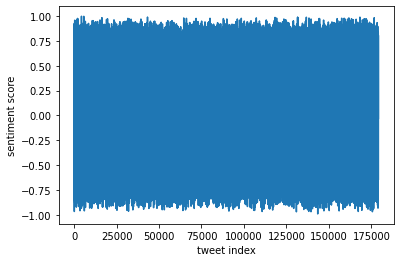

In [78]:
plt.figure()
plt.plot(df.index, df.compound)
plt.ylabel('sentiment score')
plt.xlabel('tweet index')
plt.show()

In the plot just above we can see that the plot is not informative at all. Therefore, we want to smooth it. 

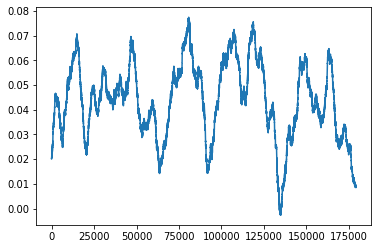

In [79]:
def smooth(y, box_pts):
    box = np.ones(box_pts)/box_pts
    # generate values by taking the sum of the products of values within the input arch and the other signal (ones)
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

def plt_compound(data): 
    smoothed_signals = smooth(list(data.compound), 4500)
    plt.figure()
    plt.plot(data.index, smoothed_signals)
    plt.show()
    
plt_compound(df)

We can also consider a portion of the tweets. For example, in the plot below we want to plot the sentiment score of a certain range of dates.

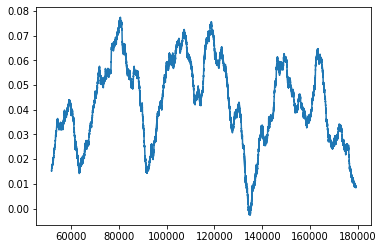

In [80]:
plt_compound(df_dates('08-01','09-01'))

Below, we see an interactive version of the plot above. 

In [81]:
# Usefull for the final Dashboard

smoothed_signals = smooth(list(df.compound), 4500)
fig_compound = px.line(df, x= df.index, y = smoothed_signals)
fig_compound.update_xaxes(title_text='Tweet index')
fig_compound.update_yaxes(title_text='Sentiment score')

After considering the sentiment score of each tweet, we want to plot the frequency of the compound score. The black line represents the mean, while the red and the green one represent respectively the first and third quantile. 

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



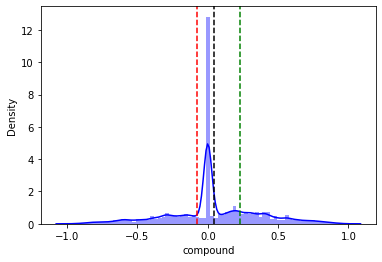

In [82]:
def freq_compound(data):
    sns.distplot(data.compound, bins=75, color='b')
    plt.axvline(x=np.mean(data.compound), color='black', ls='--')               # mean of compound
    plt.axvline(x=np.quantile(data.compound, 0.75), color='green', ls='--')     # third quartile of compound
    plt.axvline(x=np.quantile(data.compound, 0.25), color='red', ls='--')       # first quartile of compound
    plt.show()
    
freq_compound(df)

Given that the number of tweets whose compound score is equal to 0 is very high, in order to better visualize the distribution we consider the tweets whose compound score is different from 0. 

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



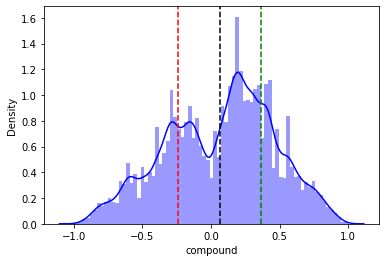

In [83]:
freq_compound(df[df.compound != 0])

Furthermore, we can discretize the value of the compound in three classes: negative, positive and neutral, adding this information to a new column of the DataFrame.

- if $compound < -0.05$: the sentiment is negative
- if $compound > 0.05$: the sentiment is positive
- if $-0.05 < compound < 0.05$: the sentiment is neutral


In [84]:
def discretize_values(values, thr):
    discretized_values = []
    for value in values:
        if value < -thr:
            discretized_values.append("negative")
        elif -thr <= value <= thr:
            discretized_values.append("neutral")
        else:
            discretized_values.append("positive")
    return discretized_values

thr=0.05
discrete_pol_scores = discretize_values(tweets_compound, thr)
    
df["text_score"] = discrete_pol_scores

In [85]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags,text_tokenized,compound,text_score
0,insightfultroll,NaN,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN,"[glad, canada, see, pandemic, raging, united, ...",0.3400,positive
1,GlobalPandemic.NET,United Kingdom,False,07-24,"[alert: after times investigation, newsom says...",NaN,"[alert, times, investigation, newsom, says, nu...",0.2960,positive
2,Euan Watt,United Kingdom,False,07-24,[having checked the data of all nation's of th...,NaN,"[checked, data, uk, deaths, england]",0.0000,neutral
3,GlobalPandemic.NET,United Kingdom,False,07-24,[alert: doctors post bikini photos to protest ...,NaN,"[alert, doctors, post, bikini, photos, protest...",-0.4767,negative
4,Brian,United States,False,07-24,[ but not a word about #covid19 spread for the...,['COVID19'],"[word, spread, last, days, portland, city, mas...",0.0000,neutral


After having calculated the score for each tweet, we want to summarize these results through a pie chart.

In [86]:
def freq_discrete(data):
    freq_map = {'negative': 0, 'neutral': 0, 'positive': 0}
    freq_map["positive"] = list(data.text_score).count("positive")
    freq_map["neutral"] = list(data.text_score).count("neutral")
    freq_map["negative"] = list(data.text_score).count("negative")
    print(freq_map)
    plt.figure(figsize=(9,7.5))
    plt.pie(freq_map.values(), labels = freq_map.keys(), autopct='%1.1f%%', colors=['r', 'b', 'g'] )

{'negative': 46439, 'neutral': 65552, 'positive': 67117}


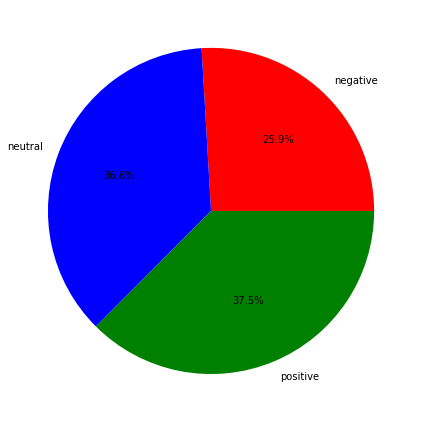

In [87]:
freq_discrete(df)

In the dataset, certain users tweeted more than others. Therefore, their sentiments are having a higher influence in the chart. Therefore, we want to group the tweets by user for the sentiment analysis.

In [88]:
# group the dataframe by user_name and do the mean of the compound values for each user_name

df_byusername = df.groupby(["user_name"])["compound"].mean()
df_byuser = pd.DataFrame({'user_name': df_byusername.index, 'compound':df_byusername.values})
df_byuser['text_score'] = discretize_values(df_byuser.compound, thr)

In [89]:
df_byuser.head()

,user_name,compound,text_score
0,2Civility,0.0000,neutral
1,Corona,-0.3243,negative
2,!!SEVEN TIMES!! IN-THE-BACK. 😡,0.0000,neutral
3,!F,0.0000,neutral
4,!Gau Khoeb,0.0000,neutral


We repeat the analysis done so far, grouping the data by users. Hence, we plot the distribution of the compound scores and then we plot it considering only the tweets with compound score different than 0. Finally, we plot the a summary of the compund score through a pie chart.

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



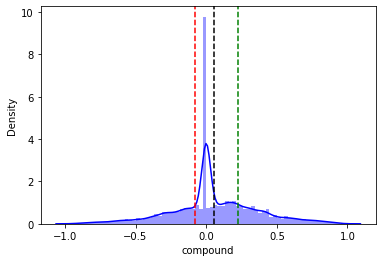

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



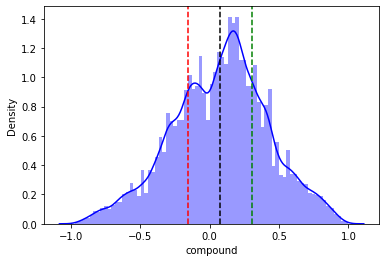

{'negative': 24837, 'neutral': 28502, 'positive': 38937}


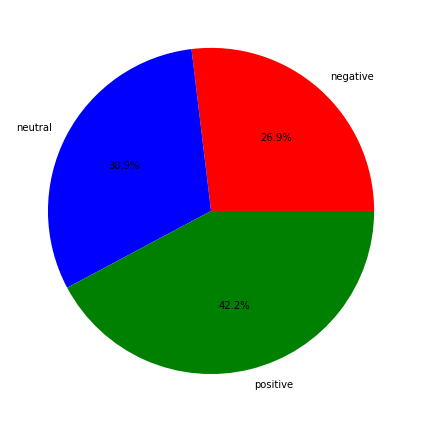

In [90]:
freq_compound(df_byuser)
freq_compound(df_byuser[df_byuser.compound != 0])
freq_discrete(df_byuser)

Here we introduce a new classification, repeating the analysis done so far for verified users and not, after having grouped tweets by user.

In [91]:
df_byusername_ver = df_usver().groupby(["user_name"])["compound"].mean()
df_byuser_ver = pd.DataFrame({'user_name': df_byusername_ver.index, 'compound':df_byusername_ver.values})
df_byuser_ver['text_score'] = discretize_values(df_byuser_ver.compound, thr)

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



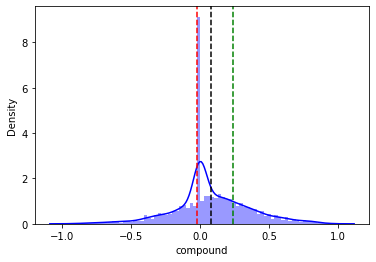

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



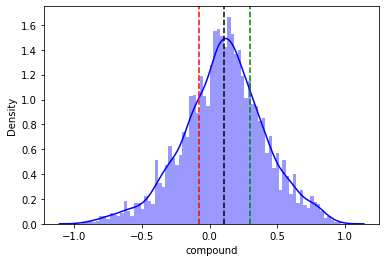

{'negative': 1409, 'neutral': 1899, 'positive': 2916}


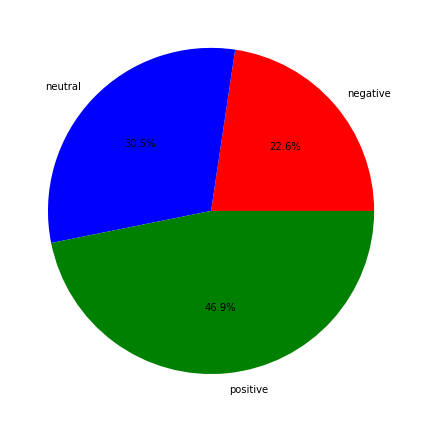

In [92]:
freq_compound(df_byuser_ver)
freq_compound(df_byuser_ver[df_byuser_ver.compound != 0])
freq_discrete(df_byuser_ver)

The same procedure is done for not verified users.

In [93]:
df_byusername_notver = df_usver(False).groupby(["user_name"])["compound"].mean()
df_byuser_notver = pd.DataFrame({'user_name': df_byusername_notver.index, 'compound':df_byusername_notver.values})
df_byuser_notver['text_score'] = discretize_values(df_byuser_notver.compound, thr)

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



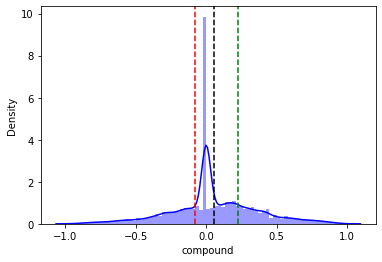

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



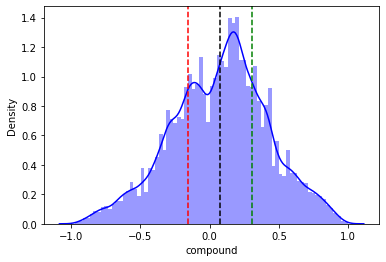

{'negative': 23453, 'neutral': 26625, 'positive': 36048}


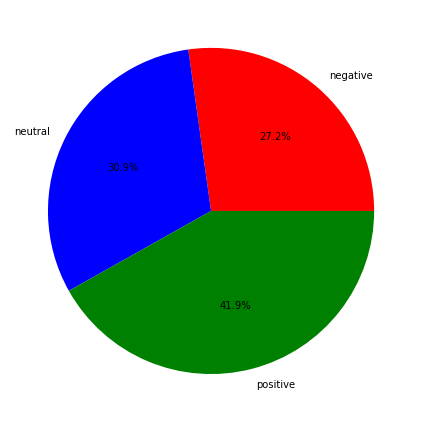

In [94]:
freq_compound(df_byuser_notver)
freq_compound(df_byuser_notver[df_byuser_notver.compound != 0])
freq_discrete(df_byuser_notver)

We can plot the frequency of the compound and a pie chart for each country. Here, we will show these plots for the United States (country who sent the most tweets) and for Italy.

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



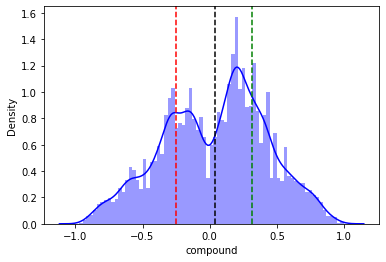

{'negative': 12157, 'neutral': 14491, 'positive': 15608}


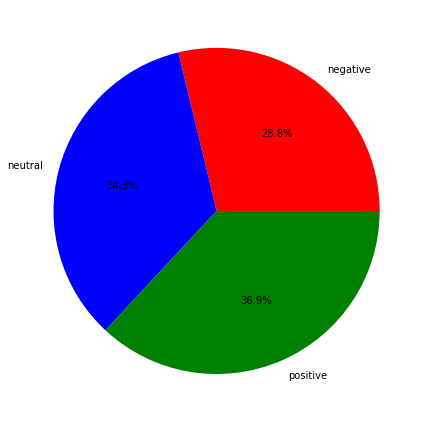

In [95]:
freq_compound(df_country('United States')[df_country('United States').compound != 0])
freq_discrete(df_country('United States'))

/home/francesco/.local/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



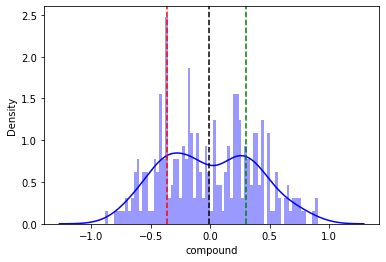

{'negative': 132, 'neutral': 220, 'positive': 120}


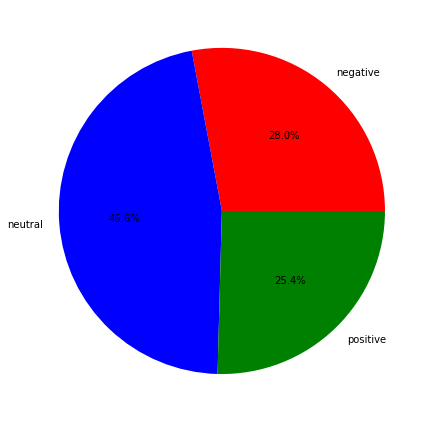

In [96]:
freq_compound(df_country('Italy')[df_country('Italy').compound != 0])
freq_discrete(df_country('Italy'))

<a id='sentiment_country'></a>
### Sentiment Analysis per Country
Here we want to consider the sentiment score per country. We will start by plotting the contries who sent the most tweets.

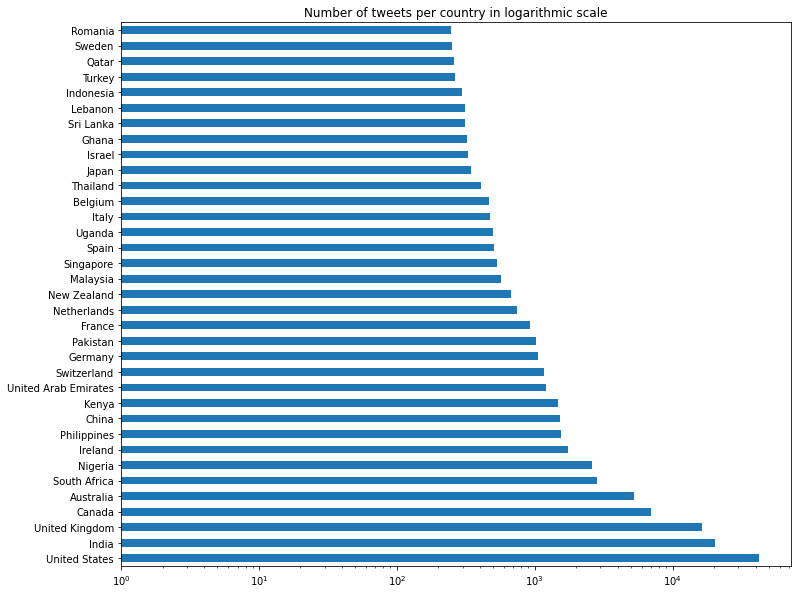

In [97]:
freq_tweet_country = FreqDist(df.user_location.dropna())
count_country = pd.Series(freq_tweet_country.values(), index = freq_tweet_country.keys())
count_country = count_country.sort_values(ascending = False)

plt.figure(figsize=(12,10))
count_country[:35].plot.barh(count_country, log = True)
plt.title('Number of tweets per country in logarithmic scale')
plt.show()

Then we want to compute the average of the compound score of the tweets sent in that country.

In [98]:
import pycountry

In [99]:
# get code iso3 for each country 

def get_country_iso3(col):
    try:
        country_code =  pycountry.countries.search_fuzzy(col)[0].alpha_3
    except:
        country_code = None 
    return country_code

In [100]:
def compound_by_country(data):
    df_bycountry = data.groupby("user_location")["compound"].mean()
    country_iso = pd.Series(df_bycountry.index).apply(get_country_iso3)
    df_byloc = pd.DataFrame({'country': list(df_bycountry.index), 'country_iso3': country_iso, 'compound': df_bycountry.values})
    df_byloc = df_byloc.dropna()
    return df_byloc

df_bycountry = compound_by_country(df)

In [101]:
df_bycountry

,country,country_iso3,compound
0,Afghanistan,AFG,0.024940
1,Africa,ZAF,0.044257
2,Albania,ALB,-0.037036
3,Algeria,DZA,-0.067310
4,Andorra,AND,0.000000
...,...,...,...
202,Venezuela,VEN,-0.034734
203,Vietnam,VNM,0.010759
204,Yemen,YEM,-0.067965
205,Zambia,ZMB,0.142479


Here we want to plot a map of the average sentiment score per country, as described in the dataset above.

In [102]:
#!pip install plotly

In [103]:
# create a choropleth map
def choropleth_map_compound(data):
    df_bycountry = compound_by_country(data)
    fig = px.choropleth(df_bycountry , 
                        locations="country_iso3",
                        color="compound", 
                        hover_name="country",
                        color_continuous_scale= 'RdYlGn')

    fig.show()
    
choropleth_map_compound(df)

We then can plot a similar map of the sentiment score per country for verified user, and for not verified users.

In [104]:
choropleth_map_compound(df_usver())

For not verified users.

In [105]:
choropleth_map_compound(df_usver(False))

We also plot a similar map for users in a certain period of time.

In [106]:
choropleth_map_compound(df_dates("08-10","08-16"))

So far, we considered the avarage sentiment score of each country, averaging on the period of days we are considering. Here, we want to consider the individual sentiment score for each day of period we are considering for each country.

In [107]:
tab = df.pivot_table(index = 'user_location', columns='date', values = 'compound', aggfunc = 'mean').T  #add margins = True for watching the tot mean

In [108]:
tab

user_location,Afghanistan,Africa,Albania,Algeria,Andorra,Angola,Antarctica,Argentina,Armenia,Asia,...,United Kingdom,United States,Uruguay,Uzbekistan,Vatican City,Venezuela,Vietnam,Yemen,Zambia,Zimbabwe
date,,,,,,,,,,,,,,,,,,,,,
07-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-0.031704,0.035530,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
07-25,-0.051667,0.034071,0.063450,-0.1027,NaN,NaN,0.000000,-0.054783,0.090383,-0.089300,...,0.068794,0.021017,0.000000,0.13085,-0.156225,-0.445500,0.091141,NaN,0.195750,0.155011
07-26,-0.025489,0.051713,0.067433,NaN,0.0,NaN,-0.022042,0.167625,0.000000,0.000000,...,0.045525,0.005225,-0.535800,NaN,NaN,0.000000,-0.129717,NaN,0.342154,0.244036
07-27,0.000000,0.144304,0.153100,NaN,NaN,NaN,0.000000,0.765650,0.000000,0.238350,...,0.059901,0.021501,0.281250,NaN,NaN,-0.312450,-0.128700,NaN,0.219683,-0.026407
07-28,0.025675,-0.096233,0.493900,0.0000,NaN,NaN,NaN,-0.062283,-0.725800,-0.023100,...,0.034477,0.019982,0.354800,0.14800,NaN,NaN,-0.134425,NaN,NaN,0.102158
07-29,NaN,0.022562,NaN,NaN,NaN,NaN,0.136600,NaN,0.278700,NaN,...,0.083465,0.049618,NaN,0.57190,NaN,NaN,0.000000,NaN,NaN,0.246950
07-30,NaN,0.354800,NaN,NaN,NaN,NaN,0.250000,0.000000,NaN,NaN,...,0.072778,0.025026,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.502300
07-31,NaN,-0.162043,-0.095320,-0.1056,NaN,NaN,0.000000,-0.247143,0.000000,0.265375,...,0.084559,0.061734,NaN,NaN,NaN,0.273200,-0.069278,NaN,0.000000,-0.165313
08-01,NaN,-0.089886,NaN,NaN,NaN,NaN,NaN,0.082233,0.000000,0.202300,...,0.048885,0.038390,-0.127267,NaN,NaN,-0.079608,0.000000,NaN,0.000000,0.165525


Here we remove from our analysis those columns that have many missing values.

In [109]:
for col in tab.columns:
    if tab[col].isna().sum() > tab.shape[0]*0.1:
        del tab[col]

In [110]:
tab

user_location,Africa,Australia,Austria,Belgium,Brazil,Canada,China,Colombia,Denmark,Ethiopia,...,South Africa,Spain,Sri Lanka,Sweden,Switzerland,Turkey,Uganda,United Arab Emirates,United Kingdom,United States
date,,,,,,,,,,,,,,,,,,,,,
07-24,NaN,-0.096474,NaN,NaN,NaN,0.109123,-0.967000,0.877900,NaN,NaN,...,0.621250,NaN,-0.340350,NaN,0.000000,NaN,NaN,NaN,-0.031704,0.035530
07-25,0.034071,0.034463,0.051165,-0.030525,0.024029,0.067053,-0.031915,0.061341,-0.019518,0.095826,...,0.101835,-0.018331,0.137841,-0.004074,0.028496,0.051624,0.002127,0.039957,0.068794,0.021017
07-26,0.051713,0.019042,-0.035769,0.077965,0.074183,0.035045,-0.025647,0.231250,-0.084489,0.123267,...,0.079449,-0.076297,0.045550,0.053000,0.004469,0.218825,0.151573,0.112713,0.045525,0.005225
07-27,0.144304,0.054700,0.007731,0.039148,0.047531,0.038174,0.040251,-0.087880,0.275680,0.068500,...,0.131124,0.060655,0.057023,0.101200,0.032746,-0.008706,-0.028731,0.089066,0.059901,0.021501
07-28,-0.096233,0.061788,-0.332788,0.025561,0.082582,0.036696,0.039695,-0.110490,-0.076357,0.188767,...,0.130425,-0.034722,0.124542,-0.168845,0.024674,-0.094493,-0.035479,0.060741,0.034477,0.019982
07-29,0.022562,-0.028910,NaN,-0.161207,0.198950,0.100157,0.220313,0.135800,-0.187580,NaN,...,0.138144,0.054025,0.159525,0.035987,0.104812,-0.066929,-0.036767,0.320807,0.083465,0.049618
07-30,0.354800,-0.130175,-0.296000,0.067150,-0.162425,0.078787,0.112767,-0.394100,-0.542300,0.024550,...,0.216822,-0.077920,NaN,-0.145433,0.068481,NaN,NaN,0.131940,0.072778,0.025026
07-31,-0.162043,0.106182,0.080219,0.025302,0.167625,0.079610,0.059751,0.075229,0.161875,0.190900,...,0.054720,0.021475,0.000000,-0.008329,0.080869,-0.164260,-0.040200,0.033820,0.084559,0.061734
08-01,-0.089886,-0.031327,0.029807,-0.184686,-0.048419,0.080573,0.022922,-0.040692,0.059940,0.316400,...,0.012284,0.238021,-0.148697,0.020442,0.039616,-0.125439,-0.081673,0.006577,0.048885,0.038390


In [111]:
tab = tab.fillna(0)

sign = np.array(tab).T

We plot a similarity matrix to establish the similarity in sentiment scores between each countries.

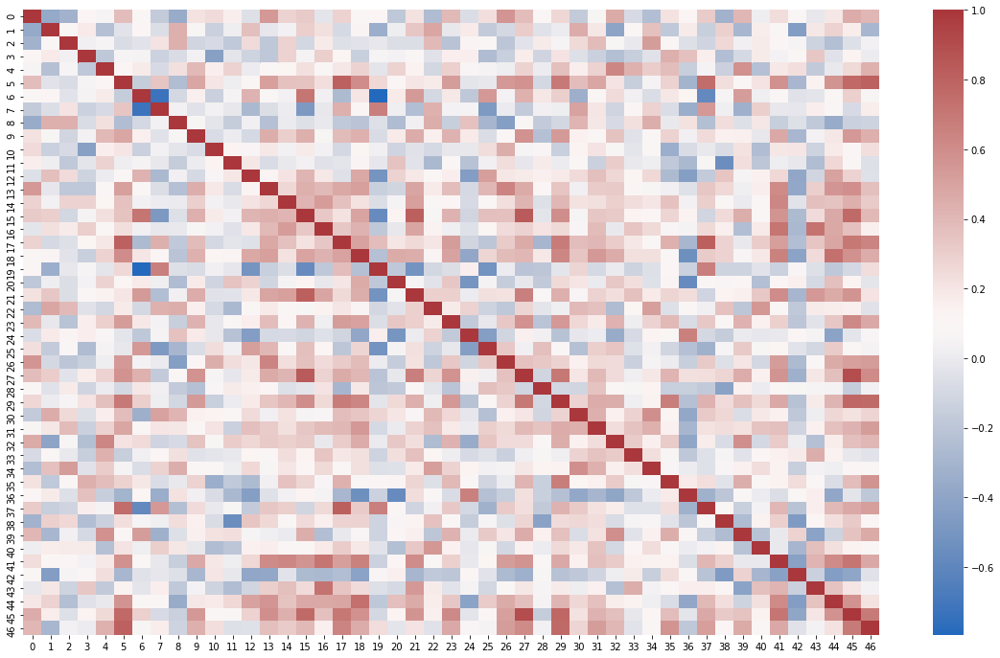

In [112]:
def get_similarity(a1, a2):
    # cosine similarity/dot product of normalized vectors
    assert len(a1) == len(a2)
    return np.dot(a1, a2)/(np.linalg.norm(a1) * np.linalg.norm(a2))
            
def compute_sim_matrix(sign):
    # compute similarity matrix across all sentiment arches
    sim_m = np.ones(shape=(sign.shape[0], sign.shape[0]))
    for i in range(sign.shape[0]):
        for j in range(sign.shape[0]):
            sim_m[i, j] = get_similarity(sign[i], sign[j])
    return sim_m


plt.figure(figsize = (20,12))
sim_m = compute_sim_matrix(sign)
ax = sns.heatmap(sim_m, cmap = "vlag")
plt.show()

(47, 26)
(47, 8)


Text(0, 0.5, 'variance %')

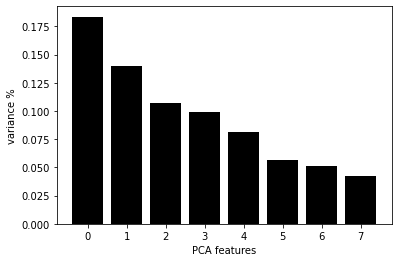

In [113]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Create a PCA instance: pca
print(sign.shape)
pca = PCA(n_components=8)
principalComponents = pca.fit_transform(sign)
print(principalComponents.shape)
# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')

<a id='sentiment_clusters'></a>
### Clusters of Countries
We want to analyze how these countries can be grouped in 5 clusters. In the graphs below, the sentiment scores of the countries belonging to that cluster are plotted. The red line represents the mean of the sentiment scores of the countries belonging to that cluster.

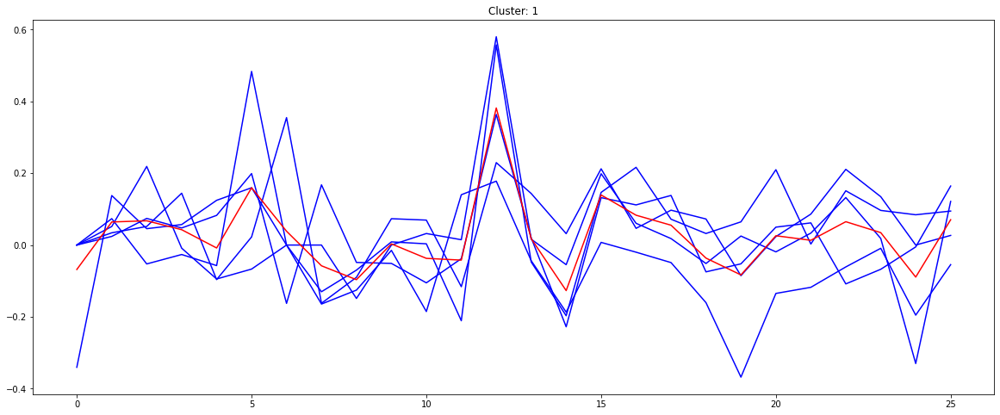

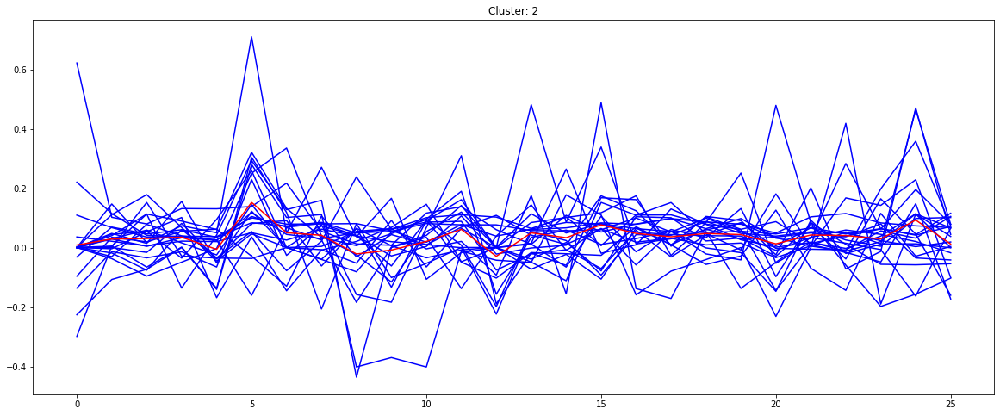

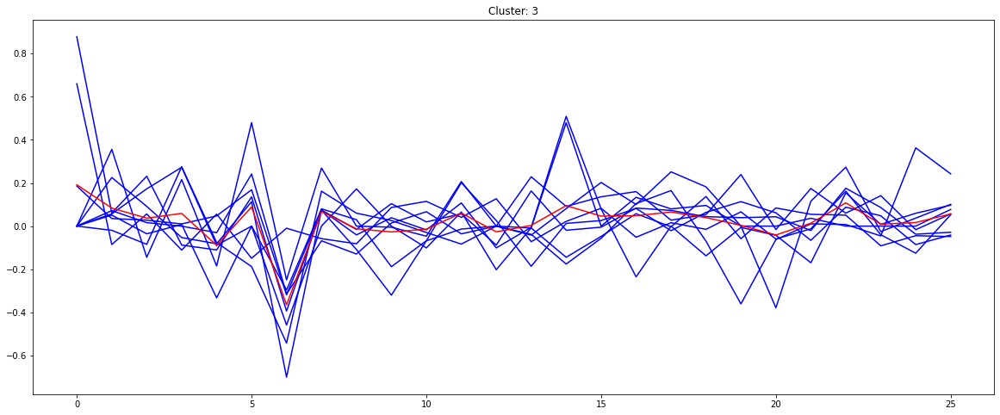

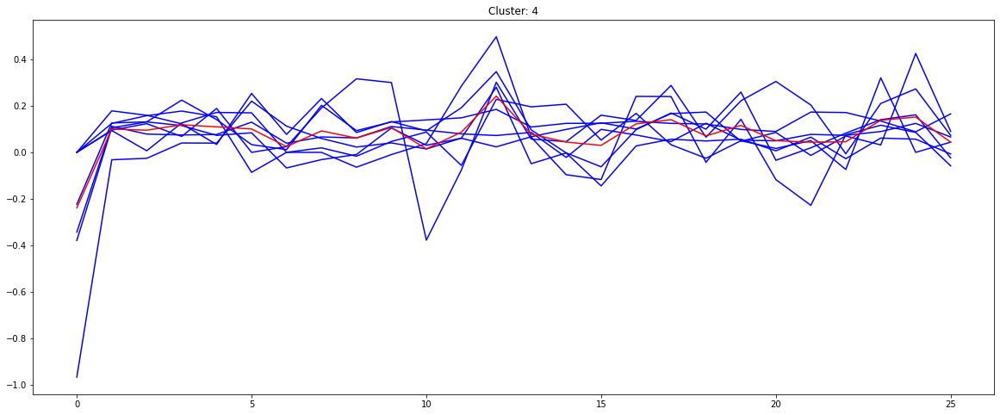

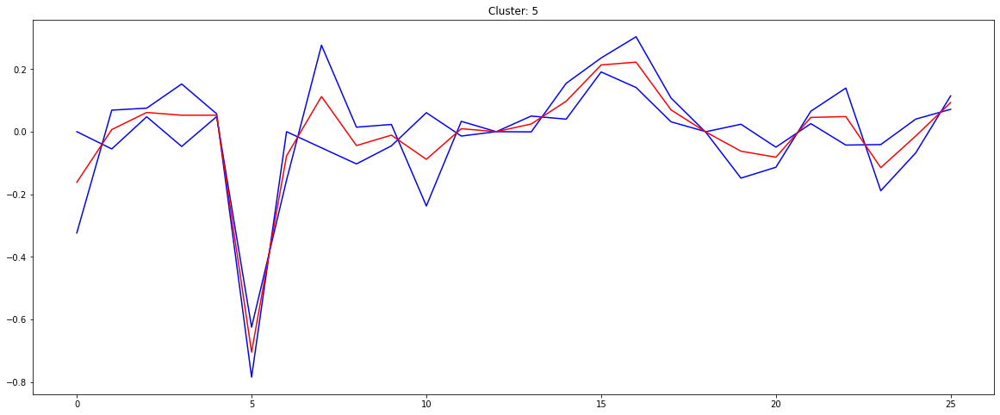

In [114]:
from sklearn.cluster import KMeans
kmeans_model = KMeans(n_clusters=5, random_state=1).fit(sign) # https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html
k_means_labels = kmeans_model.labels_ # get the index to the cluster assigned to each text

def group_arcs(sign, labels):
    grouped_sentiment_archs = {}
    for i in range(len(labels)):
        if labels[i] not in grouped_sentiment_archs.keys():
            grouped_sentiment_archs[labels[i]] = []
        grouped_sentiment_archs[labels[i]].append(sign[i])
    return grouped_sentiment_archs

def visualize_arcs_with_averages(grouped_sentiment_archs):
    averaged_clusters = np.array([np.mean(arches, axis=0) for arches in grouped_sentiment_archs.values()])
    for i, (k, v) in enumerate(grouped_sentiment_archs.items()):
        plt.figure()
        plt.title('Cluster: {}'.format(i+1))
        for arch in v:
            plt.plot(arch, c='b')
        plt.plot(averaged_clusters[i], c='r')
        fig = plt.gcf()
        fig.set_size_inches(20,8)
        
grouped_sentiment_archs = group_arcs(sign, k_means_labels)
visualize_arcs_with_averages(grouped_sentiment_archs)

In [115]:
def find_clusters_centers(docs_labels, sim_m):
    doc_groups = {}
    for i in range(len(docs_labels)):
        l = docs_labels[i]
        if l not in doc_groups.keys():
            doc_groups[l] = [i]
        else:
            doc_groups[l].append(i)
    print('documents clusters:\n{}'.format(doc_groups))
    centers_indices = []
    for k, v in doc_groups.items():
        assert len(np.mean(sim_m[v], axis=1)) == len(v)
        print('cluster {} similarity scores={}'.format(k, np.nanmean(sim_m[v], axis=1)))
        curr_g_center = v[np.argmax(np.nanmean(sim_m[v], axis=1))]
        centers_indices.append(curr_g_center)
    return centers_indices, doc_groups

centers_indices, doc_groups = find_clusters_centers(k_means_labels, sim_m)
print('central documents indices: {}'.format(centers_indices))

documents clusters:
{0: [0, 4, 32, 39, 42], 3: [1, 3, 5, 10, 11, 12, 13, 14, 16, 17, 18, 20, 25, 26, 28, 37, 38, 40, 41, 43, 44, 45, 46], 1: [2, 7, 8, 19, 22, 30, 31, 33, 34], 2: [6, 9, 15, 21, 23, 27, 29, 35], 4: [24, 36]}
cluster 0 similarity scores=[ 0.13706272  0.16186741  0.18404766  0.12852422 -0.09912803]
cluster 3 similarity scores=[0.07276489 0.04310862 0.27221498 0.05475413 0.02607478 0.1218317
 0.22703929 0.22616112 0.20195901 0.25997671 0.26963764 0.06827816
 0.06683721 0.18113985 0.02807986 0.15868203 0.08478688 0.1121265
 0.28265038 0.12596308 0.22785246 0.32526778 0.26702539]
cluster 1 similarity scores=[ 0.06331021  0.04126572  0.01246332 -0.04197029  0.12832152  0.18012796
  0.25788986  0.11095931  0.16532803]
cluster 2 similarity scores=[0.08216997 0.19932571 0.26562652 0.25259455 0.22665488 0.30404595
 0.29408895 0.16712258]
cluster 4 similarity scores=[-0.01126403 -0.05327304]
central documents indices: [32, 45, 31, 27, 24]


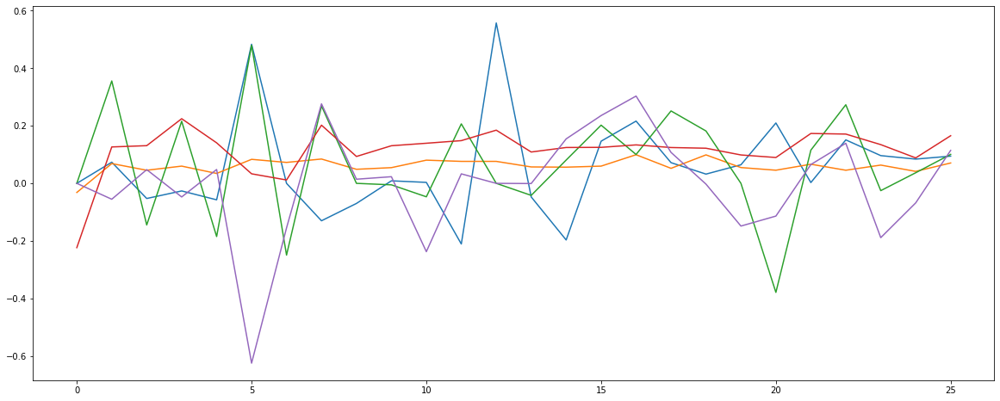

In [116]:
def plot_arches(arches):
    plt.figure()
    for arch in arches:
        plt.plot(arch)
        fig = plt.gcf()
    fig.set_size_inches(20,8)

plot_arches(sign[centers_indices])

In [117]:
for i in centers_indices:
    print(tab.columns[i])

Qatar
United Kingdom
Poland
Nigeria
Mexico


After having defined the different clusters behavior, we can create a DataFrame where we highlight in which cluster each country belongs.

In [118]:
def cluster(i):
    cluster = []
    for j in doc_groups[i]:
        cluster.append(tab.columns[j])
    return cluster

cluster_0 = cluster(0)
cluster_1 = cluster(1)
cluster_2 = cluster(2)
cluster_3 = cluster(3)
cluster_4 = cluster(4)

In [119]:
clusterSeries = pd.Series(index = tab.columns)
for x in cluster_0:
    clusterSeries[x] = 'Cluster 0'
for x in cluster_1:
    clusterSeries[x] = 'Cluster 1'
for x in cluster_2:
    clusterSeries[x] = 'Cluster 2'
for x in cluster_3:
    clusterSeries[x] = 'Cluster 3'
for x in cluster_4:
    clusterSeries[x] = 'Cluster 4'

<ipython-input-119-588eb6725158>:1: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



In [120]:
country_iso3_clust = pd.Series(clusterSeries.index).apply(get_country_iso3)
cluster_countries = pd.DataFrame({'country': list(clusterSeries.index), 'country_iso3': country_iso3_clust, 'cluster': clusterSeries.values})

In [121]:
cluster_countries

,country,country_iso3,cluster
0,Africa,ZAF,Cluster 0
1,Australia,AUS,Cluster 3
2,Austria,AUT,Cluster 1
3,Belgium,BEL,Cluster 3
4,Brazil,BRA,Cluster 0
5,Canada,CAN,Cluster 3
6,China,CHN,Cluster 2
7,Colombia,COL,Cluster 1
8,Denmark,DNK,Cluster 1
9,Ethiopia,ETH,Cluster 2


We can finally plot on a map the classification in clusters.

In [122]:
fig_cluster_countries = px.choropleth(cluster_countries , 
                                         locations="country_iso3",
                                         color="cluster", 
                                         hover_name="country")

fig_cluster_countries.show()

<a id='sentiment_countries_day'></a>
### Sentiment Analysis Spatial Temporal distribution

In this last section of sentiment analysis, we plot an animated map that shows the sentiment score of each country in each day of the period that we are considering.

In [123]:
df.head()

,user_name,user_location,user_verified,date,text,hashtags,text_tokenized,compound,text_score
0,insightfultroll,NaN,False,07-24,"[i'm glad i'm in canada, you can see why the p...",NaN,"[glad, canada, see, pandemic, raging, united, ...",0.3400,positive
1,GlobalPandemic.NET,United Kingdom,False,07-24,"[alert: after times investigation, newsom says...",NaN,"[alert, times, investigation, newsom, says, nu...",0.2960,positive
2,Euan Watt,United Kingdom,False,07-24,[having checked the data of all nation's of th...,NaN,"[checked, data, uk, deaths, england]",0.0000,neutral
3,GlobalPandemic.NET,United Kingdom,False,07-24,[alert: doctors post bikini photos to protest ...,NaN,"[alert, doctors, post, bikini, photos, protest...",-0.4767,negative
4,Brian,United States,False,07-24,[ but not a word about #covid19 spread for the...,['COVID19'],"[word, spread, last, days, portland, city, mas...",0.0000,neutral


In [124]:
df_withloc = df.dropna(subset = ['user_location'])

In [125]:
df_withloc = df_withloc[['user_location','date','compound']]

In [126]:
df_withloc

,user_location,date,compound
1,United Kingdom,07-24,0.2960
2,United Kingdom,07-24,0.0000
3,United Kingdom,07-24,-0.4767
4,United States,07-24,0.0000
5,United Kingdom,07-24,-0.3818
...,...,...,...
179095,United States,08-30,-0.1366
179096,United States,08-30,-0.5945
179099,Japan,08-30,0.0000
179103,Malaysia,08-30,0.4019


In [127]:
grouped = df.groupby('user_location')

In [128]:
ls = []
for country in df_withloc.user_location.unique():
    ls.append(grouped.get_group(country).groupby(['user_location', 'date'], as_index = False)['compound'].mean())

In [129]:
data = pd.concat(ls)

data

,user_location,date,compound
0,United Kingdom,07-24,-0.031704
1,United Kingdom,07-25,0.068794
2,United Kingdom,07-26,0.045525
3,United Kingdom,07-27,0.059901
4,United Kingdom,07-28,0.034477
...,...,...,...
0,Cook Islands,08-22,-0.757900
0,Oceanic Point of Inaccessibility,08-22,0.822500
0,Marshall Islands,08-29,0.458800
1,Marshall Islands,08-30,0.107200


In [130]:
fig_compound_per_country_animation = px.choropleth(
    data, #Dataframe
    locations= 'user_location', #Spatial coordinates, can give Lat and Lon in separate params
    locationmode= 'country names', #Type of spatial coordinates
    color= 'compound', #Values to be color coded
    range_color=[-1,1],
    hover_name= 'user_location', #Text to be displayed in Bold upon hover
    animation_frame= 'date', #Data for animation, time-series data
    color_continuous_scale=px.colors.diverging.RdYlGn
)

In [131]:
fig_compound_per_country_animation.show()

<a id='dash'></a>
## Dash Board
We want to summarize all the results found so far in a more compact and user-friendly way through a Dash Board. 

In [132]:
#!pip3 install dash

In [133]:
#!pip3 install dash_bootstrap_components

In [134]:
import dash
import dash_html_components as html
import dash_core_components as dcc
import dash_bootstrap_components as dbc
from dash.dependencies import Input, Output, State

import plotly.express as px

from io import BytesIO
import base64
from flask import Flask

In [135]:
# List of country
list_country = list(set(df['user_location'].dropna()))
list_country = sorted(list_country)

# List of day
list_day = list(set(df['date']))
list_day = sorted(list_day)

# Number of users
number_of_users = len(list(set(df['user_name'])))

#Number of tweets
number_of_tweets = len(df['text'])

#Number of countries
number_of_countries = len(list_country)

In [136]:
def hashtag_wordcloud_to_img(data):
    wc = WordCloud(width=800, height=400, max_words=50).generate_from_frequencies(data)  # create the wordcloud
    return wc.to_image()

In [137]:
def freq_discrete_df(data):
    keys = ['negative', 'neutral', 'positive']
    values = []
    pos = list(data.text_score).count("positive")
    neu = list(data.text_score).count("neutral")
    neg= list(data.text_score).count("negative")
    values.extend([neg,neu,pos])
    result = list(zip(keys,values))
    result = pd.DataFrame(result, columns = ['keys','values'])
    return result

In [138]:
SIDEBAR_STYLE = {
    'top': '0px',
    'background-color': '#f8f9fa',
    'float':'left'
}

CONTENT_STYLE = {
    'margin-left': '25%',
    'margin-right': '5%',
    'top': '0px',
    'padding': '20px 10px'
}

MAIN_STYLE = {
    'top': '0px',
    'padding': '20px 10px'
}

TEXT_STYLE = {
    'textAlign': 'center',
    'color': '#191970'
}

CARD_TEXT_STYLE = {
    'textAlign': 'center',
    'color': '#0074D9',
    'font-size': '40px',
    'font-weight': 'bold'
}

CARD_TITLE_STYLE = {
    'textAlign': 'center',
    'color': '#0074D9',
    'font-size': '19px'
}

IMG_STYLE = {
    'textAlign': 'center',
    'max-width': '100%',
    'max-height': '100%',
    'display': 'block',
    'float' : 'right'
}

FIGURE_TITLE = {
  'textAlign': 'center',
  'font-weight': 'bold',
  'display': 'flex',
  'flex-direction': 'column',
  'align-items': 'center'
}

VIDEO_STYLE = {
    'display' : 'block',
    'margin': '0 auto',
    'display': 'flex',
    'flex-direction': 'column',
    'align-items': 'center'
}

In [139]:
controls_tab1 = dbc.FormGroup(
    [
        html.Br(),
        html.P('Wordcloud of hashtags filter:', style={
            'textAlign': 'center'
        }),
        dbc.Card([dbc.RadioItems(
            id='radio_items',
            options=[{
                'label': 'Normal',
                'value': 'normal'
            },
            {
                'label': 'Without #covid and #corona',
                'value': 'without'
            },
            {
                'label': 'Verified users',
                'value': 'verified'
            },
            {
                'label': 'Not verified users',
                'value': 'nverified'
            },
            {
                'label': 'Country',
                'value': 'country'
            }],
            value = 'normal',
            style={
                'margin': 'auto'
            }
        )]),
        html.Br(),
        html.P('Country', style={
            'textAlign': 'center'
        }),
        dcc.Dropdown(
            id='dropdown_country_1',
            options=[{'label': country,'value': country}
                    for country in list_country],
            value='United States',  
            clearable=False
        ),
        html.Br(),
        dbc.Button(
            id='submit_button_1',
            n_clicks=0,
            children='Submit',
            color='primary',
            block=True
        )
    ]
)

In [140]:
trends_first_row = dbc.Row([
    dbc.Col(children =
        [dbc.Card(
            [
                dbc.CardBody(
                    [
                        html.H4(children=['Date'], className='card-title',
                                style=CARD_TITLE_STYLE),
                        html.P(children=['07/24 - 08/30'], style=CARD_TEXT_STYLE),
                    ]
                )
            ]
        ),
         dbc.Card(
            [

                dbc.CardBody(
                    [
                        html.H4(children=['Number of users'], className='card-title', style=CARD_TITLE_STYLE),
                        html.P(number_of_users, style=CARD_TEXT_STYLE),
                    ]
                ),
            ]
        )
    ], md = 6),
    dbc.Col(children =
        [dbc.Card(
            [
                dbc.CardBody(
                    [
                        html.H4(children=['Number of tweets'], className='card-title', style=CARD_TITLE_STYLE),
                        html.P(number_of_tweets, style=CARD_TEXT_STYLE),
                    ]
                ),
            ]
        ),
        dbc.Card(
            [
                dbc.CardBody(
                    [
                        html.H4(children=['Number of countries'], className='card-title', style=CARD_TITLE_STYLE),
                        html.P(number_of_countries, style=CARD_TEXT_STYLE),
                    ]
                ),
            ]
        )
       ], md=6),
    dbc.Col(children =
            [dcc.Graph(id='number_of_tweet_animation', figure = figure_number_of_tweets_per_country),
             html.Br(),
             html.P('Number of tweets animation for each country', style = FIGURE_TITLE)], md = 12 
    )
])

In [141]:
trends_second_row = dbc.Row(
    [
        dbc.Col(children = 
            [dcc.Graph(id='number_of_tweets', figure = fig_frq_words),
             html.Br(),
             html.P('Frequency of the most 20 common words in tweets', style = FIGURE_TITLE)], md=6
        ),
        dbc.Col(children =
            [dcc.Graph(id='number_of_tweets_per_day', figure = fig_number_of_tweets_per_day),
             html.Br(),
             html.P('Number of tweets per day', style = FIGURE_TITLE)], md=6)
    ]
)

In [142]:
sidebar_tab1  = html.Div([controls_tab1], style=SIDEBAR_STYLE)

In [143]:
trends_third_row = dbc.Row([
    dbc.Col(md = 2),
    dbc.Col(sidebar_tab1, md = 2),
    dbc.Col(html.Img(id="image_wc", style = IMG_STYLE), md = 6),
    dbc.Col(md = 2)
])

In [144]:
trends_fourth_row = dbc.Row(
    [
        dbc.Col(children =
            [html.Video(id = 'bcr_hashtags',src='/assets/bar_chart_race_hashtags.mp4',controls=True, style = VIDEO_STYLE),
            html.Br(),
            html.P('Bar chart race for hashtags without #covid and #corona', style = FIGURE_TITLE)],
            md=12
        )
   ]
)

In [145]:
trends_fifth_row = dbc.Row(
    [
        dbc.Col(children =
            [html.Video(id = 'bcr_countries',src='/assets/bar_chart_race_countries.mp4',controls=True, style = VIDEO_STYLE),
            html.Br(),
            html.P('Bar chart race for number of tweets per country', style = FIGURE_TITLE)],
            md=12
        ),
   ]
)

In [146]:
controls_tab2_1 = dbc.FormGroup([
        html.Br(),
        html.P('Sentiment analysis for country', style={
            'textAlign': 'center'
        }),
        html.Br(),
        html.P('Choose a country:', style={
            'textAlign': 'center'
        }),
        dcc.Dropdown(
            id='dropdown_country_2',
            options=[{'label': country,'value': country}
                    for country in list_country],
            value='United States',  
            clearable=False
        ),
        html.Br(),
        dbc.Button(
            id='submit_button_2_1',
            n_clicks=0,
            children='Submit',
            color='primary',
            block=True
        )
])

In [147]:
sidebar_tab2_1 = html.Div([controls_tab2_1], style=SIDEBAR_STYLE)

In [148]:
sentiment_analysis_first_row = dbc.Row(children =
    [
        dbc.Col(sidebar_tab2_1, md = 2),
        dbc.Col(dcc.Graph(id = 'sentiment_analysis_country_pie_chart'), md = 5),
        dbc.Col(dcc.Graph(id = 'sentiment_analysis_country_dist_plot'), md = 5)
    ]
)

In [149]:
sentiment_analysis_second_row = dbc.Row(children =
    [
        dbc.Col(children =
            [dcc.Graph(id='sentiment_score', figure = fig_compound),
            html.Br(),
            html.P('Sentiment score for tweets', style = FIGURE_TITLE)], md = 12
        )
    ])

In [150]:
controls_tab2_2 = dbc.FormGroup([
        html.Br(),
        html.P('Average sentiment score per day', style={
            'textAlign': 'center'
        }),
        html.Br(),
        html.P('Choose a day:', style={
            'textAlign': 'center'
        }),
        dcc.Dropdown(
            id='dropdown_day',
            options=[{'label': day,'value': day}
                    for day in list_day],
            value='07-24',  
            clearable=False
        ),
        html.Br(),
        dbc.Button(
            id='submit_button_2_2',
            n_clicks=0,
            children='Submit',
            color='primary',
            block=True
        )
])

In [151]:
sidebar_tab2_2 = html.Div([controls_tab2_2], style=SIDEBAR_STYLE)

In [152]:
sentiment_analysis_third_row = dbc.Row(children =
    [   dbc.Col(md=2),
        dbc.Col(sidebar_tab2_2, md = 2),
        dbc.Col(dcc.Graph(id ='compound_by_country_per_day'), md=6),
        dbc.Col(md=2)
    ])

In [153]:
sentiment_analysis_fourth_row = dbc.Row(children =
    [
        dbc.Col(children =
            [dcc.Graph(id = 'cluster_countries', figure = fig_cluster_countries),
            html.P('Countries clustering', style = FIGURE_TITLE)], md=12
        )
    ])

In [154]:
content = html.Div(
    [
        html.H2('Covid-19 Tweets Analytics Dashboard ', style=TEXT_STYLE),
        html.Hr(),
        html.P('The dataset is collected using Twitter API and a Python script. A query for this high-frequency hashtag (#covid19) is run daily for a certain time period, to collect a larger number of tweets samples.', style=TEXT_STYLE),
        dcc.Tabs(id='tab', value = 'tab', children=[
            dcc.Tab(label='Analyzing Trends', value = 'trends', children=[
                html.Br(),
                trends_first_row,
                html.Br(),
                trends_second_row,
                html.Br(),
                trends_third_row,
                html.Br(),
                trends_fourth_row,
                html.Br(),
                trends_fifth_row
            ]),
            dcc.Tab(label='Sentiment Analysis', value = 'sentiment_analysis', children=[
                sentiment_analysis_first_row,
                html.Br(),
                sentiment_analysis_second_row,
                html.Br(),
                sentiment_analysis_third_row,
                html.Br(),
                sentiment_analysis_fourth_row
            ])
        ])
    ],
    style=MAIN_STYLE
)

In [155]:
server = Flask(__name__)
app = dash.Dash(__name__, external_stylesheets=[dbc.themes.BOOTSTRAP], server = server)
app.layout = html.Div([content])
app.title = 'Twitter Sentiment Analysis'

In [156]:
#Video
@server.route('/assets/<path:path>')
def serve_static(path):
    root_dir = os.getcwd()
    return flask.send_from_directory(os.path.join(root_dir, 'assets'), path)

In [157]:
# Wordcloud
@app.callback(Output('image_wc', 'src'), 
              [Input('submit_button_1', 'n_clicks'), Input('image_wc', 'id')],
              [State('radio_items', 'value'), State('dropdown_country_1', 'value')])
def update_word_cloud(n_clicks, b, radio_items_value, dropdown_country_value):
    print(n_clicks)
    print(radio_items_value)
    print(dropdown_country_value)
    
    img = BytesIO()
    #normal
    if radio_items_value == 'normal':
        hashtag_wordcloud_to_img(fdist).save(img, format='PNG')
        return 'data:image/png;base64,{}'.format(base64.b64encode(img.getvalue()).decode())
    #without hashtag covid or corona
    elif radio_items_value == 'without':
        hashtag_wordcloud_to_img(fdist_nocovid).save(img, format='PNG')
        return 'data:image/png;base64,{}'.format(base64.b64encode(img.getvalue()).decode())
    #verified user
    elif radio_items_value == 'verified':
        fdist_verified = freq_hashtag_nocov(freq_hashtag(df_usver())[1])
        hashtag_wordcloud_to_img(fdist_verified).save(img, format='PNG')
        return 'data:image/png;base64,{}'.format(base64.b64encode(img.getvalue()).decode())
    #not verified user
    elif radio_items_value == 'nverified':
        fdist_nverified = freq_hashtag_nocov(freq_hashtag(df_usver(False))[1])
        hashtag_wordcloud_to_img(fdist_nverified).save(img, format='PNG')
        return 'data:image/png;base64,{}'.format(base64.b64encode(img.getvalue()).decode())
    #country
    elif radio_items_value == 'country':
        fdist_country = (freq_hashtag_nocov(freq_hashtag(df_country(dropdown_country_value))[1]))
        hashtag_wordcloud_to_img(fdist_country).save(img, format='PNG')
        return 'data:image/png;base64,{}'.format(base64.b64encode(img.getvalue()).decode())

In [158]:
# Sentiment analysis (pie chart)
@app.callback(Output('sentiment_analysis_country_pie_chart', 'figure'), 
              [Input('submit_button_2_1', 'n_clicks')],
              [State('dropdown_country_2', 'value')])
def update_pie_chart(n_clicks, dropdown_country_value):
    print(n_clicks)
    print(dropdown_country_value)
    freq_text_score = freq_discrete_df(df_country(dropdown_country_value))
    fig_sentiment_analysis_pie = px.pie(freq_text_score, values = 'values', names = 'keys')
    return fig_sentiment_analysis_pie

In [159]:
# Sentiment analysis (dist plot)
@app.callback(Output('sentiment_analysis_country_dist_plot', 'figure'), 
              [Input('submit_button_2_1', 'n_clicks')],
              [State('dropdown_country_2', 'value')])
def update_dist_plot(n_clicks, dropdown_country_value):
    print(n_clicks)
    print(dropdown_country_value)
    text_score_by_country = df_country(dropdown_country_value).loc[df_country(dropdown_country_value).compound != 0]
    fig_sentiment_analysis_dist = px.histogram(text_score_by_country, x = 'compound')
    return fig_sentiment_analysis_dist

In [160]:
df_bycountry = df.groupby(["user_location", 'date'], as_index = False)["compound"].mean()
country_iso = pd.Series(df_bycountry['user_location']).apply(get_country_iso3)
df_byloc = pd.DataFrame({'country': list(df_bycountry['user_location']), 'country_iso3': country_iso, 'date': list(df_bycountry['date']), 'compound': df_bycountry['compound']})
df_byloc = df_byloc.dropna()

In [161]:
# Sentiment score for countries per day
@app.callback(Output('compound_by_country_per_day', 'figure'), 
              [Input('submit_button_2_2', 'n_clicks')],
              [State('dropdown_day', 'value')])
def update_choropleth_plot(n_clicks, dropdown_day_value):
    print(n_clicks)
    print(dropdown_day_value)
    df_byloc_by_day = df_byloc.loc[df_byloc['date'] == dropdown_day_value]
    fig_compound_by_country = px.choropleth(df_byloc_by_day, 
                    locations="country_iso3",
                    color="compound", 
                    hover_name="country",
                    color_continuous_scale= 'RdYlGn', range_color = [-1,1])
    return fig_compound_by_country

In [ ]:
# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, use_reloader=False)

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on


<a id='references'></a>
## References
Bird, S., Loper E. & Klein, E. (2009). *Natural Language Processing with Python*.  O'Reilly Media Inc.

Hunter, J. D.  (2007). *Matplotlib: A 2D Graphics Environment, Computing in Science & Engineering, 9, 90-95*. DOI:10.1109/MCSE.2007.55 

Kim, Ricky (2017). *Another Twitter sentiment analysis with Python-Part 2*. Towards Data Science.

McKinney, W., & others. (2010). *Data structures for statistical computing in python*. In Proceedings of the 9th Python in Science Conference.

Oliphant, T. E. (2006). *A guide to NumPy (Vol. 1)*. Trelgol Publishing USA.

Pandey, P. (2018). *Simplifying Sentiment Analysis using VADER in Python (on Social Media Text)*. Analytics Vidhya

Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B., Grisel, O., Blondel, M., Prettenhofer, P., Weiss, R., Dubourg, V., Vanderplas, J., Passos, A., Cournapeau, D., Brucher, M., Perrot, M., Duchesnay, E. (2011). *Scikit-learn: Machine Learning in Python.* Journal of Machine Learning Research.
 
 Plotly Technologies Inc. (2015). *Collaborative data science*. Plotly Technologies Inc., Montréal, QC. https://plot.ly